In [1]:
import SimpleITK as sik
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import  glob
from scipy.spatial import ConvexHull
from Constants import Const
import joblib
from scipy.spatial.distance import cdist, pdist, squareform
import pydicom
import matplotlib as mpl
from collections import defaultdict
from scipy.spatial import Delaunay
import plotly.graph_objects as go
%matplotlib notebook

from ReaderWriter import DicomReaderWriter, folder_worker
from multiprocessing import cpu_count
import typing
import os
from queue import *
from tqdm import tqdm
from threading import Thread


In [2]:
dcm_files = glob.glob(Const.data_dir + '/DICOM/**.dcm')
dcm_files

['../data//DICOM/ima_25_uid_2.16.840.1.113662.2.2364943184436745070129103837919802504242.dcm',
 '../data//DICOM/902488_20161207T164704[HNPF]_005_RTS.dcm',
 '../data//DICOM/902488_20161207T170005[HNPF]_003_RTS.dcm',
 '../data//DICOM/902488_20161207T171405[HNPF]_001_RTS.dcm',
 '../data//DICOM/dose_uid_2.16.840.1.113669.2.931128.192763.20161117114810.147583.dcm',
 '../data//DICOM/ima_100_uid_1.2.840.113704.1.111.1072.1211221370.628.dcm',
 '../data//DICOM/ima_100_uid_1.2.840.113704.1.111.2096.1214247306.623.dcm',
 '../data//DICOM/ima_100_uid_2.16.840.1.113662.2.2364943184436745070129103837969810065985.dcm',
 '../data//DICOM/ima_101_uid_1.2.840.113704.1.111.1072.1211221370.629.dcm',
 '../data//DICOM/ima_101_uid_1.2.840.113704.1.111.2096.1214247306.624.dcm',
 '../data//DICOM/ima_101_uid_2.16.840.1.113662.2.2364943184436745070129103837969810163967.dcm',
 '../data//DICOM/ima_102_uid_1.2.840.113704.1.111.1072.1211221370.630.dcm',
 '../data//DICOM/ima_102_uid_1.2.840.113704.1.111.2096.1214247307

In [3]:
glob.glob(Const.data_dir + '/Annomyized_10153/**.dcm')

['../data//Annomyized_10153/CT1.2.840.113704.1.111.2956.1256840929.1369.dcm',
 '../data//Annomyized_10153/CT1.2.840.113704.1.111.2956.1256840929.1370.dcm',
 '../data//Annomyized_10153/CT1.2.840.113704.1.111.2956.1256840929.1371.dcm',
 '../data//Annomyized_10153/CT1.2.840.113704.1.111.2956.1256840929.1372.dcm',
 '../data//Annomyized_10153/CT1.2.840.113704.1.111.2956.1256840930.1373.dcm',
 '../data//Annomyized_10153/CT1.2.840.113704.1.111.2956.1256840930.1374.dcm',
 '../data//Annomyized_10153/CT1.2.840.113704.1.111.2956.1256840930.1375.dcm',
 '../data//Annomyized_10153/CT1.2.840.113704.1.111.2956.1256840930.1376.dcm',
 '../data//Annomyized_10153/CT1.2.840.113704.1.111.2956.1256840930.1377.dcm',
 '../data//Annomyized_10153/CT1.2.840.113704.1.111.2956.1256840930.1378.dcm',
 '../data//Annomyized_10153/CT1.2.840.113704.1.111.2956.1256840930.1379.dcm',
 '../data//Annomyized_10153/CT1.2.840.113704.1.111.2956.1256840931.1381.dcm',
 '../data//Annomyized_10153/CT1.2.840.113704.1.111.2956.12568409

In [4]:
pydicom.dcmread('../data//Annomyized_10153/strBEG.dcm')

/home/evl/andrew/anaconda3/envs/Qubbed/lib/python3.7/site-packages/pydicom/valuerep.py:290: UserWarning: The value length (18) exceeds the maximum length of 16 allowed for VR SH.
  warnings.warn(msg)
/home/evl/andrew/anaconda3/envs/Qubbed/lib/python3.7/site-packages/pydicom/valuerep.py:290: UserWarning: The value length (22) exceeds the maximum length of 16 allowed for VR SH.
  warnings.warn(msg)
/home/evl/andrew/anaconda3/envs/Qubbed/lib/python3.7/site-packages/pydicom/valuerep.py:290: UserWarning: The value length (20) exceeds the maximum length of 16 allowed for VR SH.
  warnings.warn(msg)
/home/evl/andrew/anaconda3/envs/Qubbed/lib/python3.7/site-packages/pydicom/valuerep.py:290: UserWarning: The value length (24) exceeds the maximum length of 16 allowed for VR SH.
  warnings.warn(msg)


Dataset.file_meta -------------------------------
(0002, 0000) File Meta Information Group Length  UL: 204
(0002, 0001) File Meta Information Version       OB: b'\x00\x01'
(0002, 0002) Media Storage SOP Class UID         UI: RT Structure Set Storage
(0002, 0003) Media Storage SOP Instance UID      UI: 1.2.276.0.7230010.3.1.4.727010419.147560.1492190076.3803
(0002, 0010) Transfer Syntax UID                 UI: Explicit VR Little Endian
(0002, 0012) Implementation Class UID            UI: 1.2.276.0.7230010.3.0.3.6.0
(0002, 0013) Implementation Version Name         SH: 'OFFIS_DCMTK_360'
-------------------------------------------------
(0008, 0012) Instance Creation Date              DA: '088'
(0008, 0013) Instance Creation Time              TM: '009'
(0008, 0016) SOP Class UID                       UI: RT Structure Set Storage
(0008, 0018) SOP Instance UID                    UI: 1.2.276.0.7230010.3.1.4.727010419.147560.1492190076.3803
(0008, 0020) Study Date                          DA: 

In [5]:
pydicom.dcmread('../data//DICOM/ima_160_uid_1.2.840.113704.1.111.2096.1214247325.683.dcm')

Dataset.file_meta -------------------------------
(0002, 0000) File Meta Information Group Length  UL: 184
(0002, 0001) File Meta Information Version       OB: b'\x00\x01'
(0002, 0002) Media Storage SOP Class UID         UI: CT Image Storage
(0002, 0003) Media Storage SOP Instance UID      UI: 1.2.840.113704.1.111.2096.1214247325.683
(0002, 0010) Transfer Syntax UID                 UI: Implicit VR Little Endian
(0002, 0012) Implementation Class UID            UI: 1.2.826.0.1.3680043.2.135.1066.101
(0002, 0013) Implementation Version Name         SH: '1.4.16/WIN32'
-------------------------------------------------
(0008, 0000) Group Length                        UL: 452
(0008, 0008) Image Type                          CS: ['ORIGINAL', 'PRIMARY', 'AXIAL', 'HELIX']
(0008, 0012) Instance Creation Date              DA: '001'
(0008, 0013) Instance Creation Time              TM: '001'
(0008, 0016) SOP Class UID                       UI: CT Image Storage
(0008, 0018) SOP Instance UID          

In [6]:
class BetterDicomReader(DicomReaderWriter):
    
    def __init__(self,ddir,**kwargs):
        kwargs['verbose'] = True
        kwargs['get_dose_output'] = True
        super(BetterDicomReader,self).__init__(**kwargs)
        self.walk_through_folders(ddir)
    
    def get_contour_mask_index(self,name):
        names = self.Contour_Names
        if name in names:
            return names.index(name) + 1
        return -1

    def set_by_uid(self,uid):
#         format_string = lambda x: str(x)
#         if isinstance(uid,int):
        format_string = lambda x: int(x)
    
        for key, pdict in self.series_instances_dictionary.items():
            if format_string(pdict.get('PatientID')) == format_string(uid):
                self.index = key
                return True
        print('failed to find patient id', uid)
        return False
    
    def get_all_uids(self):
        uids = [(k, pdict.get('PatientID',-1)) for k,pdict in self.series_instances_dictionary.items()]
        uids = sorted(uids, key = lambda x: x[0])
        return [u[1] for u in uids]
    
    def get_patient(self,uid=None,index=None):
        if uid is None and index is None:
            print('need index or uid')
            return False
        if uid is not None:
            if index is not None:
                print('using uid instead of index')
            format_string = lambda x: int(x)
            for key, pdict in self.series_instances_dictionary.items():
                if format_string(pdict.get('PatientID')) == format_string(uid):
                    return pdict
        else:
            pdict = self.series_instances_dictionary.get(index)
            return pdict
        
    def get_current_patient(self):
        return self.series_instances_dictionary[self.index]
    
    def walk_through_folders(self, input_path: typing.Union[str, bytes, os.PathLike],
                             thread_count=int(cpu_count() * 0.9 - 1)):
        """
        Iteratively work down paths to find DICOM files, if they are present, add to the series instance UID dictionary
        :param input_path: path to walk
        """
        paths_with_dicom = []
        for root, dirs, files in os.walk(input_path):
            dicom_files = [i for i in files if i.endswith('.dcm')]
            if dicom_files:
                paths_with_dicom.append(root)
                # dicom_adder.add_dicom_to_dictionary_from_path(dicom_path=root, images_dictionary=self.images_dictionary,
                #                                               rt_dictionary=self.rt_dictionary)
        if paths_with_dicom:
            q = Queue(maxsize=thread_count)
            pbar = tqdm(total=len(paths_with_dicom), desc='Loading through DICOM files')
            A = (q, pbar)
            threads = []
            for worker in range(thread_count):
                t = Thread(target=folder_worker, args=(A,))
                t.start()
                threads.append(t)
            for index, path in enumerate(paths_with_dicom):
                item = [path, self.images_dictionary, self.rt_dictionary, self.rd_dictionary, self.rp_dictionary,
                        self.verbose]
                q.put(item)
            for i in range(thread_count):
                q.put(None)
            for t in threads:
                t.join()
            self.__compile__()
        if self.verbose or len(self.series_instances_dictionary) > 1:
            for key in self.series_instances_dictionary:
                print('Index {}, description {} at {}'.format(key,
                                                              self.series_instances_dictionary[key]['Description'],
                                                              self.series_instances_dictionary[key]['Image_Path']))
            print('{} unique series IDs were found. Default is index 0, to change use '
                  'set_index(index)'.format(len(self.series_instances_dictionary)))
        self.__check_if_all_contours_present__()
        return None
    
    def __repr__(self):
        return str({k: v for k,v in self.series_instances_dictionary[self.index].items() if 'files' not in str(k).lower()})

# test = BetterDicomReader(Const.data_dir + '/Annomyized_10153/')
# test.set_contour_names_and_associations(Contour_Names=['tongue','ipc','GTV-N'])
# test.get_images_and_mask()
# test.mask

In [7]:
def get_associations(dr):
    associations = {}
    all_rois = dr.return_rois()
    for roi in all_rois:
        if 'ctv ' in roi.lower() or roi.lower() == 'ctv':
            associations[roi] = 'CTV'
        if 'gtv ' in roi or roi.lower() == 'gtv':
            if 'node' in roi:
                associations[roi] = 'GTVn'
            else:
                associations[roi] = 'GTVp'
        if 'oar' in roi:
            associations[roi] = roi.replace('oar','').strip()
    return associations
    
def get_all_patients(dicom_dir, rois = None, associations = None):
    if rois is None:
        rois = ['tongue','rt_sternocleidomastoid_m','lt_sternocleidomastoid_m'] + ['GTVp']
    dr = BetterDicomReader(dicom_dir)
    if associations is None:
        associations = get_associations(dr)
    dr.set_contour_names_and_associations(Contour_Names=rois,associations=associations)
    
    all_uids = dr.get_all_uids()
    plist = []
    roi_map = {i+1: roi for i,roi in enumerate(rois)}
    for uid in all_uids:
        dr.set_by_uid(uid)
        dr.get_images_and_mask()
        patient = dr.get_current_patient()
        patient['ArrayDicom'] = dr.ArrayDicom[:]
        patient['mask'] = dr.mask[:]
        patient['roi_mask_map'] = roi_map
        plist.append(patient)
    return plist, roi_map

def cloud_centroid(points):
    return (points.max(axis=0) + points.min(axis=0))/2
  
def convex_hull(points):
    hull = ConvexHull(points=points)
    hull_points = points[hull.vertices]
    return hull_points

def concave_hull_3d(pos, alpha=None, ratio = None):
    #edited from other code I cant find anymore using an alpha-shape algorith
    #defaults to mean radius as alpha value based on testing
    """
    Compute the alpha shape (concave hull) of a set of 3D points.
    Parameters:
        pos - np.array of shape (n,3) points.
        alpha - alpha value.
    return
        outer surface vertex indices, edge indices, and triangle indices
    """

    tetra = Delaunay(pos)
    # Find radius of the circumsphere.
    # By definition, radius of the sphere fitting inside the tetrahedral needs 
    # to be smaller than alpha value
    # http://mathworld.wolfram.com/Circumsphere.html
    tetrapos = np.take(pos,tetra.vertices,axis=0)
    normsq = np.sum(tetrapos**2,axis=2)[:,:,None]
    ones = np.ones((tetrapos.shape[0],tetrapos.shape[1],1))
    a = np.linalg.det(np.concatenate((tetrapos,ones),axis=2))
    Dx = np.linalg.det(np.concatenate((normsq,tetrapos[:,:,[1,2]],ones),axis=2))
    Dy = -np.linalg.det(np.concatenate((normsq,tetrapos[:,:,[0,2]],ones),axis=2))
    Dz = np.linalg.det(np.concatenate((normsq,tetrapos[:,:,[0,1]],ones),axis=2))
    c = np.linalg.det(np.concatenate((normsq,tetrapos),axis=2))
    r = np.sqrt(Dx**2+Dy**2+Dz**2-4*a*c)/(2*np.abs(a) + .001)
    r = np.nan_to_num(r)
    # Find tetrahedrals
    if alpha is None:
        if ratio is not None:
            alpha = np.quantile(r,[ratio]) 
        else:
            alpha = np.mean(r)
    tetras = tetra.vertices[r<alpha,:]
    # triangles
    TriComb = np.array([(0, 1, 2), (0, 1, 3), (0, 2, 3), (1, 2, 3)])
    Triangles = tetras[:,TriComb].reshape(-1,3)
    Triangles = np.sort(Triangles,axis=1)
    # Remove triangles that occurs twice, because they are within shapes
    TrianglesDict = defaultdict(int)
    for tri in Triangles:
        TrianglesDict[tuple(tri)] += 1
    Triangles=np.array([tri for tri in TrianglesDict if TrianglesDict[tri] ==1])
    #edges
    EdgeComb=np.array([(0, 1), (0, 2), (1, 2)])
    Edges=Triangles[:,EdgeComb].reshape(-1,2)
    Edges=np.sort(Edges,axis=1)
    Edges=np.unique(Edges,axis=0)

    Vertices = np.unique(Edges)
    return pos[Vertices]#,Edges,Triangles

def pcloud_to_convex_hull(roi_clouds):
    temp = {}
    for k,v in roi_clouds.items():
        if v.shape[0] > 3:
            hull_points = convex_hull(v)
            temp[k] = hull_points
        else:
            temp[k] = v
    return temp

def pcloud_to_concave_hull(roi_clouds,**kwargs):
    temp = {}
    for k,v in roi_clouds.items():
        if v.shape[0] > 3:
            hull_points = concave_hull_3d(v,**kwargs)
            temp[k] = hull_points
        else:
            temp[k] = v
    return temp

def filter_pcloud_outliers(points, maxq = .95, min_k = 3):
    #removes all points that have less than min_k neighbors at within the bottom maxq % in terms of distance
    if points.shape[0] < 10:
        return points
    dists = pdist(points)
    square_dists = squareform(dists)
    (maxval) = np.quantile(dists,[maxq])
    good = (square_dists < maxval).sum(axis=1)
    good = (good >= min_k)
    return points[good]

def get_roi_pointclouds(pdict, roi_map, scale = True, concavify=False,**kwargs):
    #get locations of contours.  I may need to tweak this part if I want to get actual dose values?
    clouds = {}
    mask = pdict['mask']
    #get array locations
    all_points = []
    for index, roi in roi_map.items():
        #should be x, y, z if I tranpose it (default it's slicexheightxwidth)
        contour = np.argwhere(mask.T == index)
        if contour.shape[0] > 3:
            #this should get the points on the surface of the object (concave hull) if parameters are good
            #not recommened right now
            if concavify:
                contour = concave_hull_3d(contour,**kwargs)
            all_points.append(contour)
        clouds[roi] = contour
    #correct for centroid of all points and scale to distance values
    if scale:
        #I'm not actually sure this is valid test later somehow
        #but recenters the points and then uses thickness to scale x,y, and z
        #may have issues if missing some organs when comparing between patients?
        all_points = np.vstack(all_points)
        center = cloud_centroid(all_points)
        zscale = pdict['Slice_Thickness']
        xscale = pdict['Pixel_Spacing_X']
        yscale = pdict['Pixel_Spacing_Y']
        if xscale != yscale:
            print('different height/widht scales',xscale,yscale)
        for k,v in clouds.items():
            if v.shape[0] < 1:
                continue
            v = v - center
            v[0,:] = v[0,:]*xscale
            v[1,:] = v[1,:]*yscale
            v[2,:] = v[2,:]*zscale
            v = filter_pcloud_outliers(v)
            clouds[k] = v
    
    return clouds

def pointcloud_distance(pc1,pc2,metric='euclidean'):
    #this assumes they're alread convex hulls
    if pc1.shape[0] < 1 or pc2.shape[0] < 1:
        return False
    cdists = cdist(pc1,pc2,metric)
    if cdists.shape[0] < 1:
        return False
    min_dist = cdists.min()
    
    #this should check for overlap
    #somewhat simple, but looks at closests points and checks if source roi is closer
    #to target's centroid than the point on the target roi
    min_locs = np.argwhere(cdists==min_dist)
    target_center = cloud_centroid(pc2)
    
    for min_args in min_locs:
        min_pc1 = pc1[min_args[0]]
        min_pc2 = pc2[min_args[1]]
        if np.linalg.norm(min_pc1 - target_center) < np.linalg.norm(min_pc1 - target_center):
            return -min_dist
    return min_dist

def pc_dist_worker(args):
    if args[0] == args[1]:
        return 0
    clouds = args[2]
    return pointcloud_distance(clouds[args[0]],clouds[args[1]])

def get_interorgan_distances(roi_clouds, roi_map=None, concavify=False,parallel=True,**kwargs):
    if roi_map is not None:
        rois = [roi_map[k] for k in sorted(roi_map)]
    else:
        rois = list(roi_clouds.keys())
    dists = []
    #get convex hull for interorgan_distance if I remove that from the default processing
    if concavify:
        roi_clouds = pcloud_to_concave_hull(roi_clouds,**kwargs)
    for roi in rois:
        if parallel:
            dlist = joblib.Parallel(n_jobs=-2)(joblib.delayed(pc_dist_worker)((roi,r2,roi_clouds)) for r2 in rois)
        else:
            dlist = [pc_dist_worker((roi,r2,roi_clouds)) for r2 in rois]     
        dists.append(dlist)
        print(roi,'done')

    return np.array(dists), rois

def calc_spatial_info(pdict):
    #adds each roi's convex hull as a list of points and calculates inter-organ min distances
    temp = {k: v for k, v in pdict.items()}
    roi_clouds = get_roi_pointclouds(pdict, roi_map=roi_map,scale=True)
    io_dists, rois = get_interorgan_distances(roi_clouds, roi_map)
    temp['contours'] = roi_clouds
    temp['distances'] = io_dists
    return temp

def process_patient_list(plist, roi_map = None):
    new_plist = joblib.Parallel(n_jobs=1)(joblib.delayed(calc_spatial_info)(pdict) for pdict in plist)
#     for pdict in plist:
#         temp = calc_spatial_info(pdict)
#         new_plist.append(temp)
    return new_plist

rois = ['GTVp','GTVn',
        'brainstem',
#         'cricoid_cartilage',
#         'cricopharnygeal_muscle',
        'esophagus',
#         'genioglossus_m',
        'hard_palate',
#         'hyoid_bone',
        'ipc','larynx','lower_lip',
        'lt_ant_digastric_m','rt_ant_digastric_m',
        'lt_mastoid','rt_mastoid',
        'lt_masseter_m','rt_masseter_m',
        'mpc','ipc','spc',
        'soft_palate','upper_lip',
        'rt_sternocleidomastoid_m','lt_sternocleidomastoid_m',
       ]
plist, roi_map = get_all_patients(Const.data_dir + '/DICOM/',rois=rois)
plist = process_patient_list(plist,roi_map)
plist

Loading through DICOM files:   0%|                        | 0/1 [00:00<?, ?it/s]

Loading from ../data//DICOM/
Had an error loading ../data//DICOM/dose_uid_2.16.840.1.113669.2.931128.192763.20161117114810.147583.dcm
Had an error loading ../data//DICOM/plan_uid_2.16.840.1.113669.2.931128.192763.20161117114809.595057.dcm


Loading through DICOM files: 100%|████████████████| 1/1 [00:01<00:00,  1.30s/it]


Compiling dictionaries together...
Index 0, description  at ../data//DICOM/
Index 1, description  at ../data//DICOM/
Index 2, description  at ../data//DICOM/
Index 3, description None at ../data//DICOM/
4 unique series IDs were found. Default is index 0, to change use set_index(index)
The following ROIs were found
brainstem
c1_vertebra
c2_vertebra
c3_vertebra
c4_vertebra
c5_vertebra
c6_vertebra
c7_vertebra
cricoid_cartilage
cricopharyngeal_muscle
esophagus
extended_oral_cavity
genioglossus_m
glottic_area
hard_palate
hyoid_bone
ipc
larynx
lower_lip
lt_ant_digastric_m
lt_anterior_scalene_m
lt_anterior_seg_eyeball
lt_brachial_plexus
lt_buccinator_m
lt_clavicle
lt_internal_carotid_a
lt_internal_jugular_v
lt_lateral_pterygoid_m
lt_levator_scapulae_m
lt_masseter_m
lt_mastoid
lt_medial_pterygoid_m
lt_parotid_gland
lt_post_digastric_m
lt_posterior_scalenes_m
lt_posterior_seg_eyeball
lt_sternocleidomastoid_m
lt_submandibular_gland
lt_thyroid_lobe
lt_trapezius_m
mandible
manubrium
mpc
mylogenioh

[{'PatientID': '001',
  'SeriesInstanceUID': '1.2.840.113704.1.111.2624.1214247243.15',
  'Files': ('../data//DICOM/ima_174_uid_1.2.840.113704.1.111.2096.1214247328.697.dcm',
   '../data//DICOM/ima_173_uid_1.2.840.113704.1.111.2096.1214247328.696.dcm',
   '../data//DICOM/ima_172_uid_1.2.840.113704.1.111.2096.1214247328.695.dcm',
   '../data//DICOM/ima_171_uid_1.2.840.113704.1.111.2096.1214247328.694.dcm',
   '../data//DICOM/ima_170_uid_1.2.840.113704.1.111.2096.1214247328.693.dcm',
   '../data//DICOM/ima_169_uid_1.2.840.113704.1.111.2096.1214247327.692.dcm',
   '../data//DICOM/ima_168_uid_1.2.840.113704.1.111.2096.1214247327.691.dcm',
   '../data//DICOM/ima_167_uid_1.2.840.113704.1.111.2096.1214247326.690.dcm',
   '../data//DICOM/ima_166_uid_1.2.840.113704.1.111.2096.1214247326.689.dcm',
   '../data//DICOM/ima_165_uid_1.2.840.113704.1.111.2096.1214247326.688.dcm',
   '../data//DICOM/ima_164_uid_1.2.840.113704.1.111.2096.1214247326.687.dcm',
   '../data//DICOM/ima_163_uid_1.2.840.113704

In [8]:


def plotly_pcloud(points):
    fig = go.Figure(
        data=[
            go.Scatter3d(
                x=points[:,0], y=points[:,1], z=points[:,2], 
                mode='markers',
                marker=dict(size=1.2)
            )
        ],
        layout=dict(
            scene=dict(
                xaxis=dict(visible=False),
                yaxis=dict(visible=False),
                zaxis=dict(visible=False)
            )
        )
    )
    fig.show()
    return 

def plotly_contours(pdict):
    contours = pdict['contours']
    data = []
    for organ, points in contours.items():
        if points.shape[0] < 5:
            continue
        points = concave_hull_3d(points)
        color = 'gray'
        if 'gtvp' in organ.lower():
            color = 'red'
        elif 'gtvn' in organ.lower():
            color = 'yellow'
        subplot = go.Scatter3d(
            x=points[:,0], y=points[:,1], z=points[:,2], 
            text=organ,
            mode='markers',
            marker=dict(size=1.2,color=color)
        )
        data.append(subplot)
    fig = go.Figure(
        data = data,
        layout=dict(
            scene=dict(
                xaxis=dict(visible=False),
                yaxis=dict(visible=False),
                zaxis=dict(visible=False)
            )
        )
    )
    return fig
plotly_contours(plist[-1]).show()

/home/evl/andrew/anaconda3/envs/Qubbed/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in sqrt


<IPython.core.display.Javascript object>


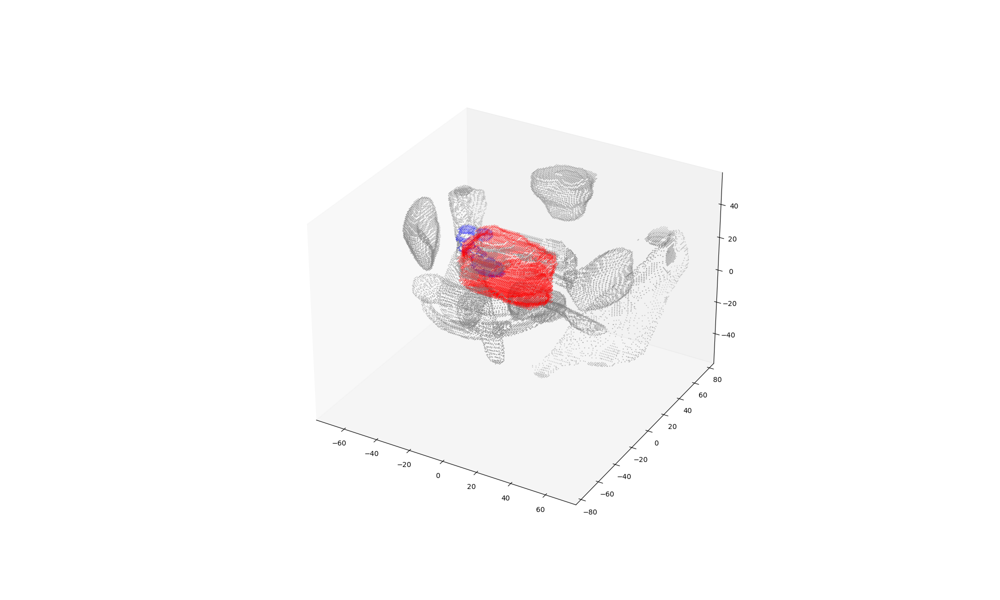

/home/evl/andrew/anaconda3/envs/Qubbed/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning:

invalid value encountered in sqrt



GTVp 39136 10464
GTVn 2624 1024
brainstem 13350 2590
esophagus 3930 952
hard_palate 1800 949
larynx 8233 2760
lower_lip 2220 825
lt_ant_digastric_m 2242 729
rt_ant_digastric_m 2256 861
lt_mastoid 486 297
rt_mastoid 252 182
lt_masseter_m 12136 1914
rt_masseter_m 11660 2629
mpc 687 320
spc 2795 886
soft_palate 2212 481
upper_lip 3169 993
rt_sternocleidomastoid_m 21273 3232
lt_sternocleidomastoid_m 22302 1790


<Axes3DSubplot:>

In [9]:
def plot_pclouds(pdict,figsize=(20,12),convexify=True,**kwargs):
    fig = plt.figure(figsize=figsize,facecolor='w')
    ax = fig.add_subplot(projection='3d')
    ax.set_facecolor('w')
    ax.grid(False)
    colors = mpl.colormaps['tab20']
    contours = pdict['contours']
    for i,(roi,pointcloud) in enumerate(contours.items()):
        if pointcloud.shape[0] < 4:
            continue
        size = .2
        if convexify:
            preshape = pointcloud.shape[0]
            pointcloud =concave_hull_3d(pointcloud,**kwargs)
            print(roi, preshape,pointcloud.shape[0])
#             size = 1
#         color=colors(i)
        color = 'red' if 'gtvp' in roi.lower() else ('blue' if 'gtvn' in roi.lower() else 'grey')
        ax.scatter(pointcloud[:,0],pointcloud[:,1],pointcloud[:,2],s=size,color=color)
    return ax

# filter_pcloud_outliers(plist[-1]['contours']['spc']).shape
plot_pclouds(plist[-1],alpha=None)

In [ ]:
#Below is my attempt at converting the point cloud to a mesh
#nothing works yet

In [39]:
import open3d as o3d
def numpy_to_o3d(pointcloud):
    pcd =o3d.geometry.PointCloud()
    pcd.points = o3d.utility.Vector3dVector(pointcloud)
    return pcd

def numpy_to_mesh_poisson(pointcloud,depth=6):
    pointcloud = concave_hull_3d(pointcloud)
    cloud = numpy_to_o3d(pointcloud)
    cloud.estimate_normals()
    try:
        mesh = o3d.geometry.TriangleMesh.create_from_point_cloud_poisson(cloud, depth=depth)[0]
    except Exception as e:
        print(e)
        mesh = False
    return mesh

def numpy_to_mesh_alpha_shape(pointcloud,alpha=.05):
    pcd = numpy_to_o3d(pointcloud)
    pcd.estimate_normals()
    try:
        tetra_mesh, pt_map = o3d.geometry.TetraMesh.create_from_point_cloud(pcd)
        mesh = o3d.geometry.TriangleMesh.create_from_point_cloud_alpha_shape(pcd, alpha, tetra_mesh, pt_map)
    except Exception as e:
        try: 
            mesh = o3d.geometry.TriangleMesh.create_from_point_cloud_alpha_shape(pcd, 2*alpha, tetra_mesh, pt_map)
        except Exception as ee:
            print(ee)
            mesh = False
    return mesh

def numpy_to_mesh_ball_pivoting(pointcloud,radii=[.5,1,10,50,100,1000]):
    pcd = numpy_to_o3d(pointcloud)
    pcd.estimate_normals()
    try:
        mesh = o3d.geometry.TriangleMesh.create_from_point_cloud_ball_pivoting(pcd, o3d.utility.DoubleVector(radii))
    except Exception as e:
        print(e)
        mesh = False
    return mesh

def numpy_to_mesh(pc, algorithm = 'poisson', **kwargs):
    if 'alpha' in algorithm:
        return numpy_to_mesh_alpha_shape(pc,**kwargs)
    if 'ball' in algorithm:
        return numpy_to_mesh_ball_pivoting(pc,**kwargs)
    else:
        if algorithm != 'poisson':
            print('wrong algorithm name in numpy_to_mesh',algorithm,'defaulting to poisson')
        return numpy_to_mesh_poisson(pc,**kwargs)

def get_meshes(pdict,**kwargs):
    meshes = {}
    for roi, item in pdict['contours'].items():
        if item.shape[0] < 5:
            continue
        mesh = numpy_to_mesh(item,**kwargs)
        if mesh:
            meshes[roi] = mesh
    missed = [c for c in pdict['contours'].keys() if c not in meshes]
    if len(missed) > 0:
        print('missed', missed)
    return meshes

meshes = get_meshes(plist[-1])
meshes

/home/evl/andrew/anaconda3/envs/Qubbed/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning:

invalid value encountered in sqrt



missed ['ipc']


{'GTVp': TriangleMesh with 18264 points and 36466 triangles.,
 'GTVn': TriangleMesh with 3818 points and 7502 triangles.,
 'brainstem': TriangleMesh with 5811 points and 11510 triangles.,
 'esophagus': TriangleMesh with 3885 points and 7576 triangles.,
 'hard_palate': TriangleMesh with 6818 points and 13390 triangles.,
 'larynx': TriangleMesh with 12282 points and 24464 triangles.,
 'lower_lip': TriangleMesh with 5170 points and 10213 triangles.,
 'lt_ant_digastric_m': TriangleMesh with 4570 points and 8926 triangles.,
 'rt_ant_digastric_m': TriangleMesh with 4161 points and 8164 triangles.,
 'lt_mastoid': TriangleMesh with 3121 points and 6032 triangles.,
 'rt_mastoid': TriangleMesh with 4740 points and 8983 triangles.,
 'lt_masseter_m': TriangleMesh with 5662 points and 11180 triangles.,
 'rt_masseter_m': TriangleMesh with 10974 points and 21834 triangles.,
 'mpc': TriangleMesh with 3298 points and 6433 triangles.,
 'spc': TriangleMesh with 3956 points and 7698 triangles.,
 'soft_pal

In [40]:
def plot_mesh(mesh):
    triangles = np.asarray(mesh.triangles)
    vertices = np.asarray(mesh.vertices)
    colors = (1.0, 0.0, 0.0)
    fig = go.Figure(
        data=[
            go.Mesh3d(
                x=vertices[:,0],
                y=vertices[:,1],
                z=vertices[:,2],
                i=triangles[:,0],
                j=triangles[:,1],
                k=triangles[:,2],
                facecolor=colors,
                opacity=0.50
            )
        ],
        layout=dict(
            scene=dict(
                xaxis=dict(visible=False),
                yaxis=dict(visible=False),
                zaxis=dict(visible=False)
            )
        )
    )
    fig.show()
    return

def plot_meshes(meshes=None,pdict=None,depth = 10):
    if meshes is None:
        meshes = get_meshes(plist[-1],depth=depth)
    data = []
    for roi, mesh in meshes.items():
        triangles = np.asarray(mesh.triangles)
        vertices = np.asarray(mesh.vertices)
        colors = (1.0, 0.0, 0.0)
        submesh =  go.Mesh3d(
                x=vertices[:,0],
                y=vertices[:,1],
                z=vertices[:,2],
                i=triangles[:,0],
                j=triangles[:,1],
                k=triangles[:,2],
                facecolor=colors,
                opacity=0.50
            )
        data.append(submesh)
    fig = go.Figure(
        data=data,
        layout=dict(
            scene=dict(
                xaxis=dict(visible=False),
                yaxis=dict(visible=False),
                zaxis=dict(visible=False)
            )
        )
    )
    fig.show()
    return

plot_meshes(meshes)

In [13]:
def display_slices(pdict, indexes = None, skip=1):
    """
    Displays a series of slices in z-direction that contains the segmented regions of interest.
    Ensures all contours are displayed in consistent and different colors.
        Parameters:
            image (array-like): Numpy array of image.
            mask (array-like): Numpy array of mask.
            skip (int): Only print every nth slice, i.e. if 3 only print every 3rd slice, default 1.
        Returns:
            None (series of in-line plots).
    """
    image = pdict['ArrayDicom']
    mask = pdict['mask']
    print(np.unique(mask))
    if indexes is None:
        indexes = [c for c in np.unique(mask) if c != 0]
    slice_locations = np.unique(np.where( np.isin(mask,indexes) )[0]) # get indexes for where there is a contour present 
    if slice_locations.shape[0] < 1:
        return False
    slice_start = slice_locations[0] # first slice of contour 
    slice_end = slice_locations[len(slice_locations)-1] # last slice of contour
    
    counter = 1
    
    for img_arr, contour_arr in zip(image[slice_start:slice_end+1], mask[slice_start:slice_end+1]): # plot the slices with contours overlayed ontop
        if counter % skip == 0: # if current slice is divisible by desired skip amount 
            masked_contour_arr = np.ma.masked_where(contour_arr == 0, contour_arr)
            plt.imshow(img_arr, cmap='gray', interpolation='none')
            plt.imshow(masked_contour_arr, cmap='cool', interpolation='none', alpha=0.5, vmin = 1, vmax = np.amax(mask)) # vmax is set as total number of contours so same colors can be displayed for each slice
            plt.show()
        counter += 1
        
display_slices(plist[0],indexes=[25])

[ 0  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21]


False